## Adaptive subtraction

In this notebook we apply adaptive subtraction to correct an initial estimate of the multiples in seismic data. Adaptive may be described by the inverse problem

$$
    x_{\star} = arg\min_x \Vert Mx - d\Vert_p + \lambda\Vert x\Vert_q,
$$

where $M$ denotes convolution with an initial estimate of the multiples, $d$ is the total data including primaries and multiples, $x_{\star}$ is the estimated multiples after adaptive subtraction and $\Vert\cdot\Vert_p$ denotes a norm. Guitton et al. have shown that the $L_1$-norm $\Vert\cdot\Vert_1$ on the data is more appropriate than the standard $L_2$-norm $\Vert\cdot\Vert_2^2$-norm for adaptive subtraction. One drawback is that minimizing the $L_1$-norm is non-trivial due to the non-smoothness of the $L_1$-norm, leaving standard gradient-based optimization methods useless. A common approach is to use the Iterative Reweighted Least-Squares (IRLS) algorithm, that solves

$$
    x_{k+1} = arg\min_x \frac{1}{2}\Vert W_k(Mx - d)\Vert_2^2 + \Vert V_kx\Vert_2^2,
$$

where $W_k = \text{diag}\left(\frac{1}{\vert Mx_k - d\vert}\right)$, $V_k = \text{diag}\left(\frac{1}{\vert x_k\vert}\right)$. In this notebook we propose a modified version of the Alternating Direction Method of Multipliers (ADMM), that solves the $L_1$-$L_1$ regularized problem via the following iterations:

\begin{eqnarray*}
x_{k+1} & = & \text{FISTA}\left(M, d + y_k - z_k, \frac{\lambda}{\rho}, x_0=x_k, \text{niter=niter}\right) \\
y_{k+1} & = & \text{soft_thresh}_{1/\rho}\left(Mx_{k+1} - d + z_k\right) \\
z_{k+1} & = & z_k + Mx_{k+1} - y_{k+1} - d
\end{eqnarray*}


First, we load the necessasry libraries

In [46]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import time
import warnings
warnings.filterwarnings('ignore')

import os
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import segyio
import matplotlib.patches as patches
from scipy.sparse.linalg import lsqr

from pylops.utils.wavelets import ricker
from pylops.utils.seismicevents import makeaxis, hyperbolic2d
from pylops.utils import dottest
from pylops import LinearOperator
from pylops.signalprocessing import Radon2D
from pylops.optimization.sparsity import FISTA
import pylops

from ADMM import ADMM
from IRLS import IRLS
from pylops.optimization.leastsquares import RegularizedInversion

# foldername = f'/Volumes/dig/Data/Voring'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Example from Guitton et al.

First we create the data and the multiples from the paper

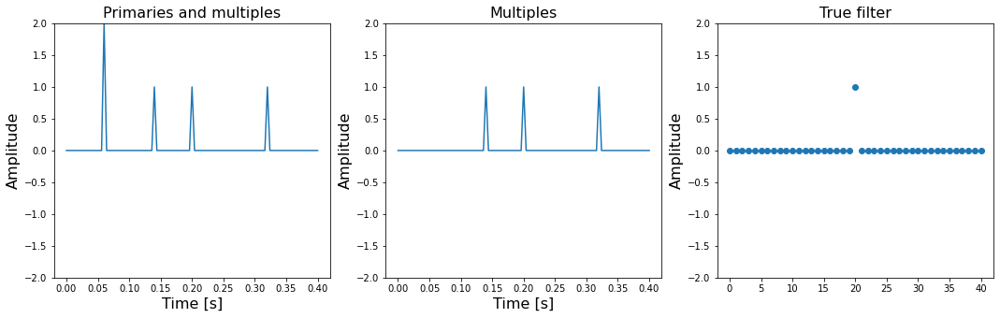

In [35]:
nt = 101
nfilt = 41
t = np.linspace(0, 0.4, nt)
data = np.zeros(nt)
data[np.argwhere(t == 0.06)] = 2
data[np.argwhere(t == 0.14)] = 1
data[np.argwhere(t == 0.20)] = 1
data[np.argwhere(t == 0.32)] = 1
multiples = data.copy()
multiples[np.argwhere(t == 0.06)] = 0
idx = np.argwhere(t == 0.14)[0][0]
mark = [i for i in range(idx-nfilt//2, idx+nfilt//2)]
filt_true = np.zeros(nfilt)
filt_true[20] = 1
# plt.plot(vals,poly,markevery=mark, ls="", marker="o", label="points")

# plot the data and the multiples
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
# axs[0].plot(t, data, markevery=mark, marker="o", label="points", markerfacecolor='r', markeredgecolor='r')
axs[0].plot(t, data)
axs[0].set_ylim(-2,2);
axs[0].set_ylabel('Amplitude', fontsize=16)
axs[0].set_xlabel('Time [s]', fontsize=16);
axs[0].set_title('Primaries and multiples', fontsize=16)
axs[1].plot(t, multiples)
axs[1].set_ylim(-2,2);
axs[1].set_ylabel('Amplitude', fontsize=16)
axs[1].set_xlabel('Time [s]', fontsize=16);
axs[1].set_title('Multiples', fontsize=16);
axs[2].plot(filt_true, 'o')
axs[2].set_ylim(-2,2);
axs[2].set_ylabel('Amplitude', fontsize=16)
axs[2].set_title('True filter', fontsize=16);

Now we make the convolutional operator

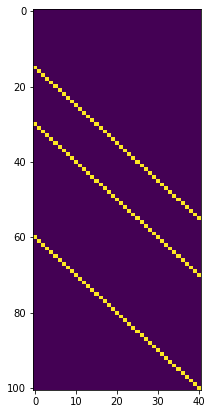

In [11]:
C = pylops.utils.signalprocessing.convmtx(multiples, nfilt)
C = C[nfilt//2:-(nfilt//2)]
fig, axs = plt.subplots(1, 1, figsize=(3,7))
axs.imshow(C, aspect='auto');

Now we try to reconstruct the primaries and multiples via adaptive subtraction using the $L_2$ norm. For this simple example, $\lambda = 0$ so there is no regularization.

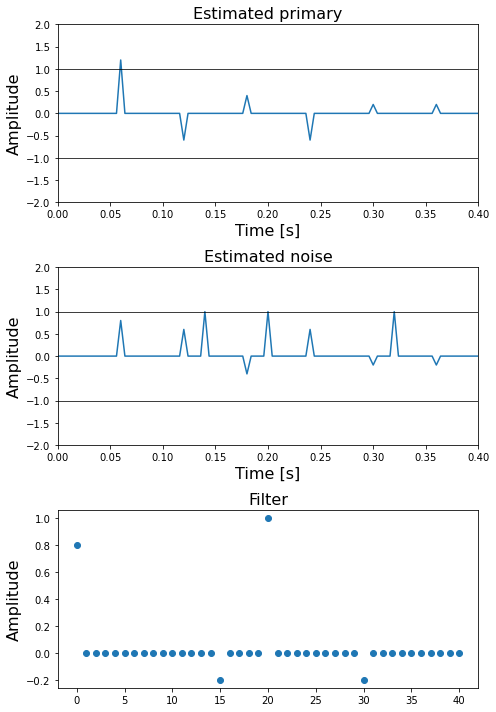

In [22]:
filt = lsqr(C, data, iter_lim=25)[0]
multiple_est = np.dot(C, filt)
primary_est = data - multiple_est

# plot the estimated primary and the estimated multiples after adaptive subtraction
fig, axs = plt.subplots(3, 1, figsize=(7, 10))
axs[0].plot(t, primary_est)
axs[0].set_ylim(-2,2);
axs[0].set_ylabel('Amplitude', fontsize=16)
axs[0].set_xlabel('Time [s]', fontsize=16);
axs[0].set_title('Estimated primary', fontsize=16)
axs[0].set_xlim(0, 0.4)
axs[0].axhline(y=1, color='k', linewidth=0.75)
axs[0].axhline(y=-1, color='k', linewidth=0.75)
axs[1].plot(t, multiple_est)
axs[1].axhline(y=1, color='k', linewidth=0.75)
axs[1].axhline(y=-1, color='k', linewidth=0.75)
axs[1].set_ylim(-2,2);
axs[1].set_ylabel('Amplitude', fontsize=16)
axs[1].set_xlabel('Time [s]', fontsize=16);
axs[1].set_title('Estimated noise', fontsize=16);
axs[1].set_xlim(0, 0.4);
axs[2].plot(filt,'o')
axs[2].set_ylabel('Amplitude', fontsize=16)
axs[2].set_title('Filter', fontsize=16);
plt.tight_layout()

Since the $L_2$-norm mimimizes the energy, the data misfit is as low as possible. However, Guitton et al. argue that for adaptive subtraction this is the wrong criterion. Instead, the $L_1$-norm is more appropriate, which we will now use to get the correct primaries and multiples.

In [24]:
Cop = pylops.basicoperators.MatrixMult(C)
filt_l1 = ADMM(Cop, data.ravel(), rho=1e0, nouter=100, ninner=10, eps=0e0)

Error is 0.00000
Residual is 2.00000


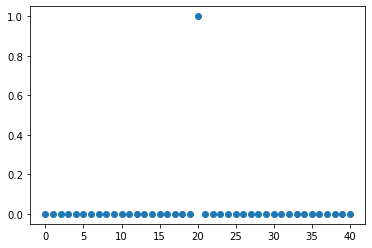

In [43]:
plt.plot(filt_l1,'o');
multiple_l1 = Cop * filt_l1
primary_l1 = data - multiple_l1
error = np.linalg.norm(filt_l1 - filt_true) / np.linalg.norm(filt_true)
residual = np.linalg.norm(multiple_l1 - data, 1)
print(f'Error is {error:.5f}')
print(f'Residual is {residual:.5f}')

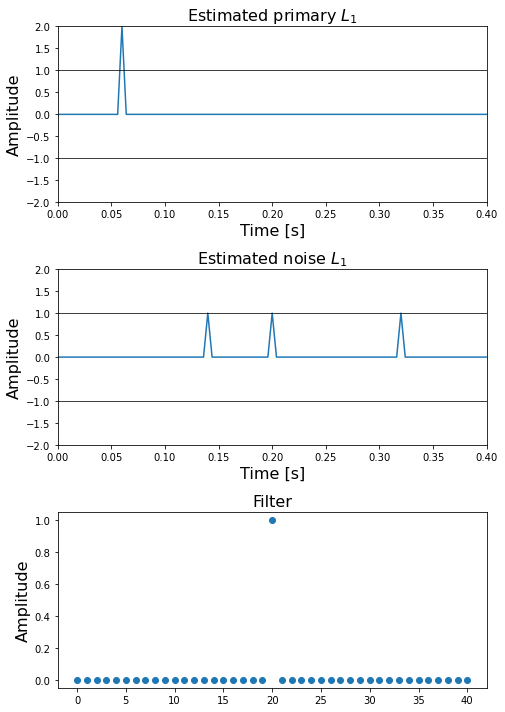

In [41]:
# plot the estimated primary and the estimated multiples after adaptive subtraction
fig, axs = plt.subplots(3, 1, figsize=(7, 10))
axs[0].plot(t, primary_l1)
axs[0].set_ylim(-2,2);
axs[0].set_ylabel('Amplitude', fontsize=16)
axs[0].set_xlabel('Time [s]', fontsize=16);
axs[0].set_title('Estimated primary $L_1$', fontsize=16)
axs[0].set_xlim(0, 0.4)
axs[0].axhline(y=1, color='k', linewidth=0.75)
axs[0].axhline(y=-1, color='k', linewidth=0.75)
axs[1].plot(t, multiple_l1)
axs[1].axhline(y=1, color='k', linewidth=0.75)
axs[1].axhline(y=-1, color='k', linewidth=0.75)
axs[1].set_ylim(-2,2);
axs[1].set_ylabel('Amplitude', fontsize=16)
axs[1].set_xlabel('Time [s]', fontsize=16);
axs[1].set_title('Estimated noise $L_1$', fontsize=16);
axs[1].set_xlim(0, 0.4);
axs[2].plot(filt_l1,'o')
axs[2].set_ylabel('Amplitude', fontsize=16)
axs[2].set_title('Filter', fontsize=16);
plt.tight_layout()

Let's compare the energy for the $L_2$-norm and the $L_1$-norm:

In [40]:
print(f'Energy for L_2-norm solution: {np.linalg.norm(data - multiple_est)**2:.2f}')
print(f'Energy for L_1-norm solution: {np.linalg.norm(multiple_l1 - data)**2:.2f}')

Energy for L_2-norm: 2.40
Energy for L_1-norm: 4.00


From this example we see that the $L_1$-norm is a more appropriate norm when there is a strong primary dominating the energy. Even though the energy for the $L_1$-norm solution is higher, the reconstructed primaries and multiples are correct. 

This example is quite simple because it is 1D. More importantly, the example is simple because the estimated multiples and the multiples in the total data area the same. Generally, the estimated multiples are not aligned with the multiples in the total data, and that is why adaptive subtraction is needed. We now move to a field data example with the Voring dataset where we have the total data and an initial estimate of the multiples.

## Voring data

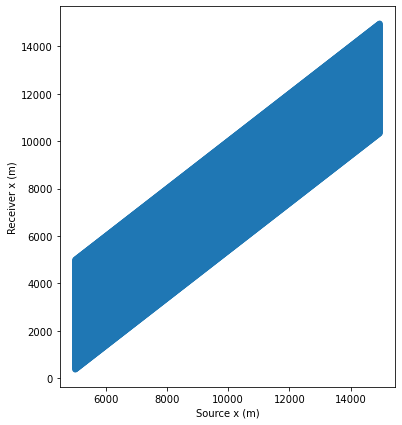

Numer of traces is 74214 
First shot is 627 and last shot is 1025
Numer of shots is 398 
found trace for shot 627 in trace nr 0
found trace for shot 627 in trace nr 1
found trace for shot 627 in trace nr 2
found trace for shot 627 in trace nr 3
found trace for shot 627 in trace nr 4
found trace for shot 627 in trace nr 5
found trace for shot 627 in trace nr 6
found trace for shot 627 in trace nr 7
found trace for shot 627 in trace nr 8
found trace for shot 627 in trace nr 9
found trace for shot 627 in trace nr 10
found trace for shot 627 in trace nr 11
found trace for shot 627 in trace nr 12
found trace for shot 627 in trace nr 13
found trace for shot 627 in trace nr 14
found trace for shot 627 in trace nr 15
found trace for shot 627 in trace nr 16
found trace for shot 627 in trace nr 17
found trace for shot 627 in trace nr 18
found trace for shot 627 in trace nr 19
found trace for shot 627 in trace nr 20
found trace for shot 627 in trace nr 21
found trace for shot 627 in trace nr 22
f

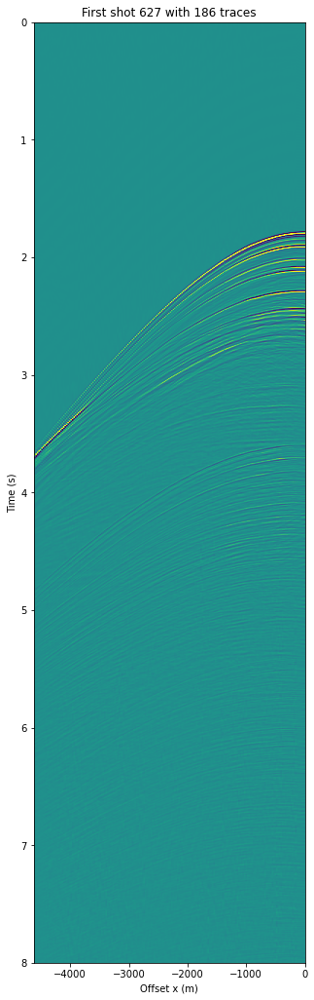

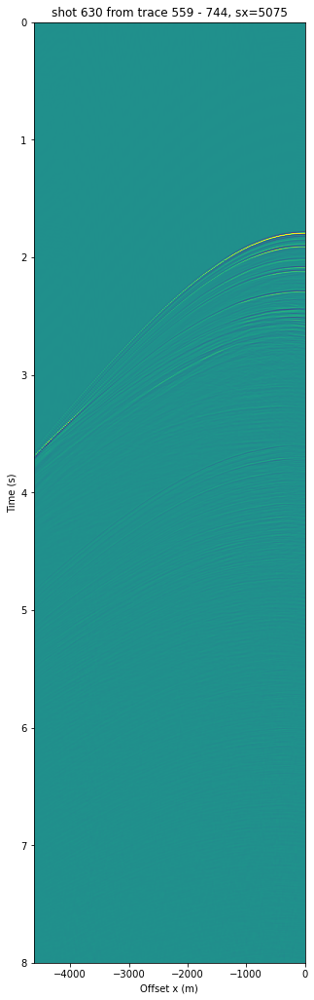

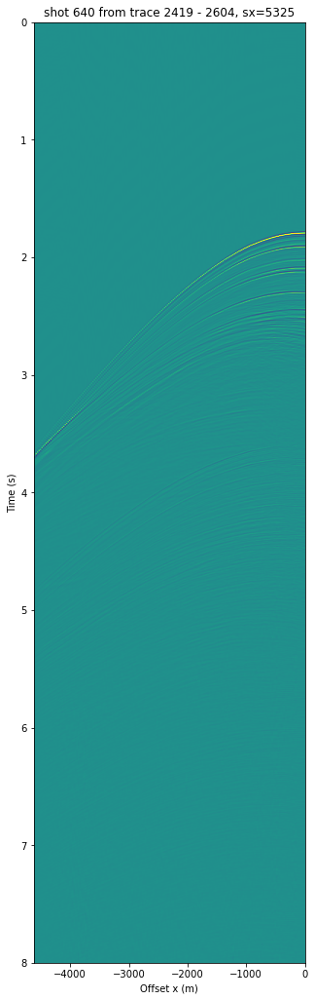

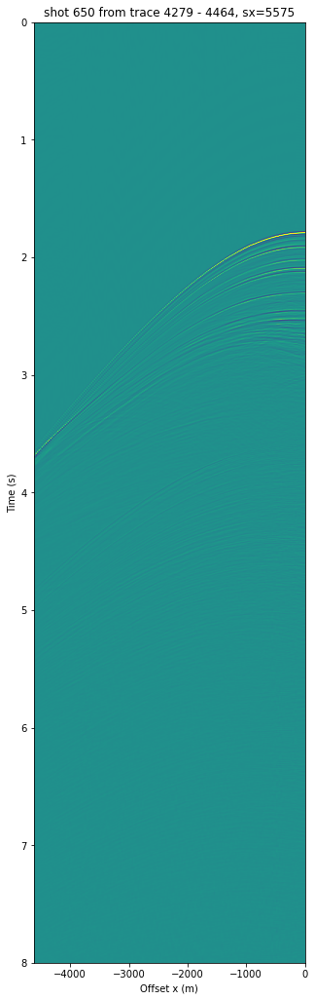

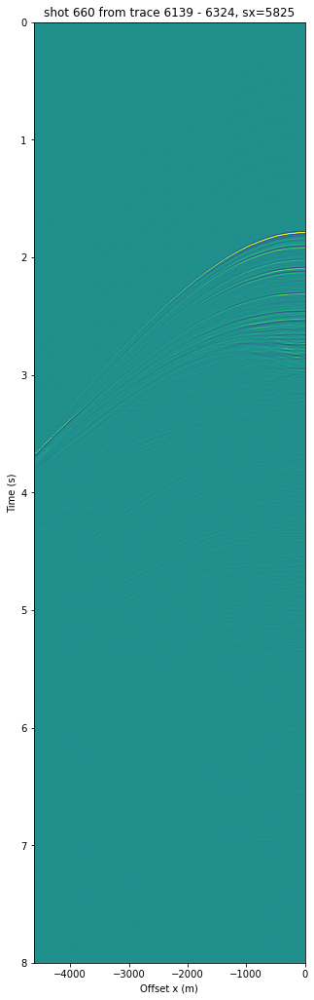

...

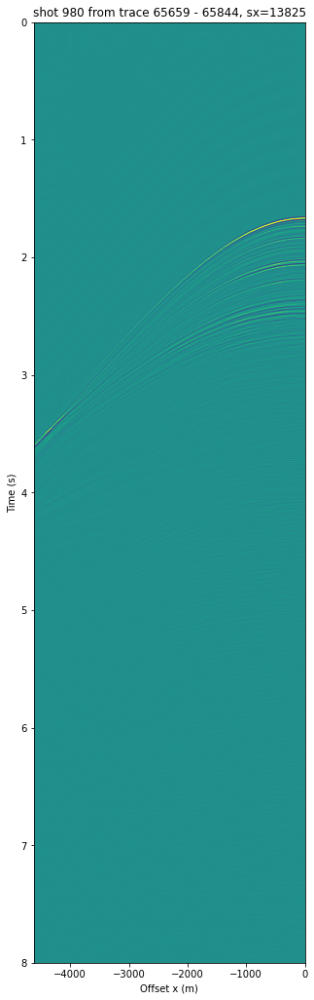

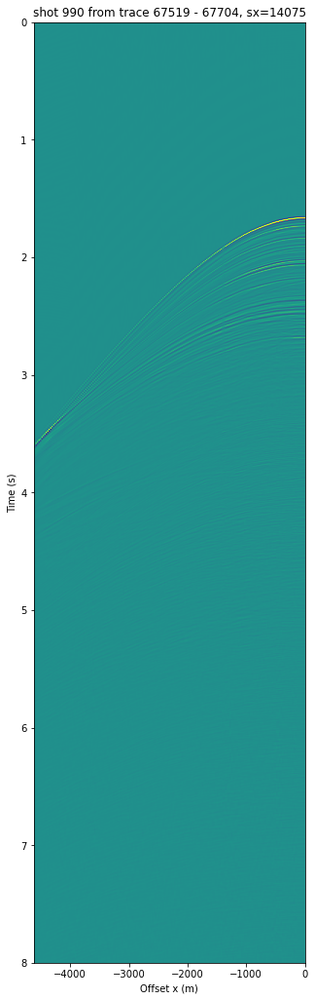

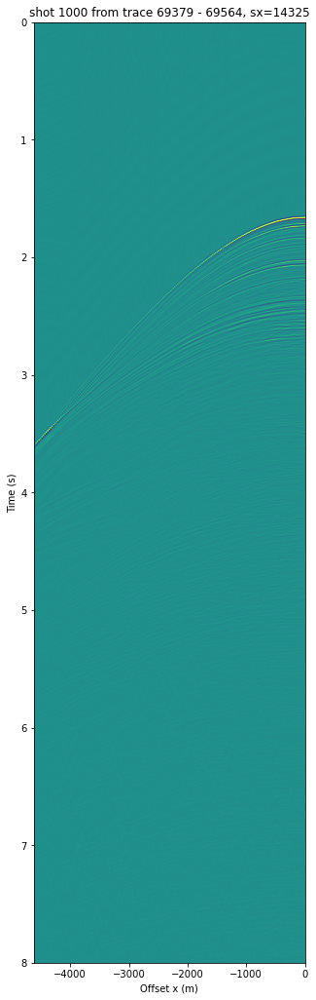

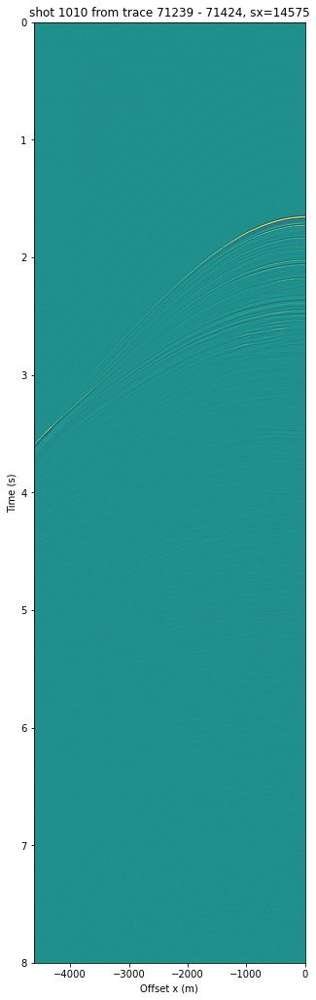

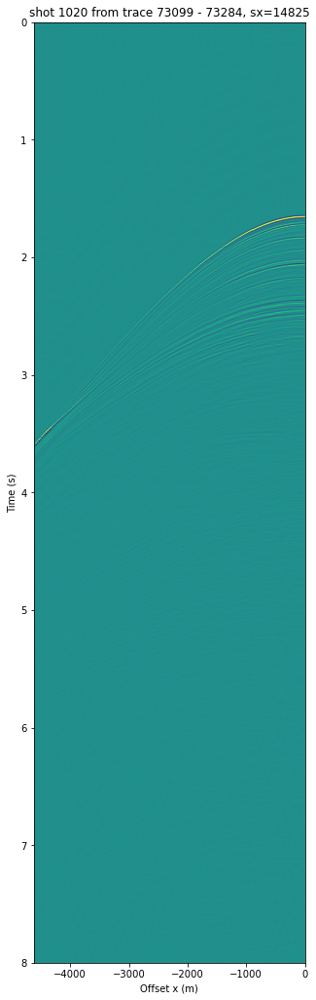

In [2]:
# read the Saga Voring shots file

filename = 'shots.inter.su'
filename = 'shots.srme.su'

with segyio.su.open(filename, ignore_geometry=True, endian='little') as sufile:
    # map all the headers
    sufile.mmap()
    
    # Extract some headers for all traces
    fldr = sufile.attributes(segyio.su.fldr)[:]
    offset = sufile.attributes(segyio.su.offset)[:]
    tracf = sufile.attributes(segyio.su.tracf)[:]
    sx = sufile.attributes(segyio.su.sx)[:]
    gx = sufile.attributes(segyio.su.gx)[:]
    ns_all = sufile.attributes(segyio.su.ns)[:]
    ns=ns_all[0]
    dtus_all = sufile.attributes(segyio.su.dt)[:]
    dtus=dtus_all[0]
    scalco_all = sufile.attributes(segyio.su.scalco)[:]
    scalco=scalco_all[0]
    ntr=len(fldr)
    
    # determine from scalco scale factor for the coordinates
    scl=1.0
    if scalco <0 :
        scl=1 / abs(scalco)
    if scalco > 0:
        scl=abs(scalco)
        
    # determine dt from dtus
    dt=dtus/1000000

    # Scatter plot of shot numbers versus trace numbers
    plt.figure(figsize=(6,7))
    plt.scatter(sx*scl, gx*scl, edgecolor='none')
    plt.xlabel('Source x (m)')
    plt.ylabel('Receiver x (m)')
    plt.show()
    time.sleep(1)

    # display some info
    print('Numer of traces is %d ' %(ntr))
    print('First shot is %d and last shot is %d' %(fldr[0],fldr[ntr-1]))
    print('Numer of shots is %d ' %(fldr[ntr-1]-fldr[0]))

    # select traces of the first shot and store in array data
    nxshot=0
    for itr in range(ntr):
        # only select first shot
        if fldr[itr]==fldr[0]:
            print('found trace for shot %d in trace nr %d' %(fldr[0],itr))
            if nxshot==0:
                data=sufile.trace[itr]
                xmin=offset[itr]
                dx=offset[itr+1]-offset[itr]
            else:
                data=np.vstack((data,sufile.trace[itr]))
            nxshot=nxshot+1
            xmax=offset[itr]

    # plot the selected shot
    vmax=0.2*np.amax(data)
    vmin=-vmax
    t0=0.0
    t1=t0+(ns-1)*dt
    plt.figure(figsize=[5,20])
    plt.imshow(data.T, aspect=2000, vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0])
    plt.title('First shot %d with %d traces' %(fldr[0],nxshot))
    plt.xlabel('Offset x (m)')
    plt.ylabel('Time (s)')
    plt.show()
    time.sleep(1)


    # Find boundaries for all shots, store in array data and plot each disp_inc^th shot
    shot_complete=0
    disp_inc=10 # display every dipinc^th shot
    nxshot=0
    for itr in range(ntr):
        # determine start of a new shot
        if nxshot == 0:
            # found new shot
            #print('found new shot %d at trace %d' %(fldr[itr],itr))                
            itr1=itr
            nxshot=1
            fldr_current=fldr[itr]
            data=sufile.trace[itr]
        else:
            #print('add trace %d to current shot' %(itr))
            data=np.vstack((data,sufile.trace[itr]))
            nxshot=nxshot+1
            itr2=itr
                
        # if next trace is from new shot or at last trace: mark complete
        if itr < ntr-1:
            if fldr[itr+1]!=fldr_current:
                shot_complete=1
        else:
                shot_complete=1
                
        # process the shot if it is complete: display it
        if shot_complete>0:
            # display if this is the disp_inc^th shot
            if fldr_current%disp_inc==0:
                plt.figure(figsize=[5,20])
                vmax=0.5*np.amax(data)
                vmin=-vmax
                xmin=offset[itr1]
                xmax=offset[itr2]
                sxscl=sx[itr1]*scl
                plt.imshow(data.T, aspect=2000, vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0])
                plt.title('shot %d from trace %d - %d, sx=%d' %(fldr_current,itr1+1,itr2+1,sxscl))
                plt.xlabel('Offset x (m)')
                plt.ylabel('Time (s)')
                plt.show()
            # prepare for next shot
            shot_complete=0
            nxshot=0


First we load the total data including the primaries and multiples

In [44]:
filename = 'shots.inter.su'

with segyio.su.open(filename, ignore_geometry=True, endian='little') as sufile:
    # map all the headers
    sufile.mmap()
    
    # Extract some headers for all traces
    fldr = sufile.attributes(segyio.su.fldr)[:]
    offset = sufile.attributes(segyio.su.offset)[:]
    tracf = sufile.attributes(segyio.su.tracf)[:]
    sx = sufile.attributes(segyio.su.sx)[:]
    gx = sufile.attributes(segyio.su.gx)[:]
    ns_all = sufile.attributes(segyio.su.ns)[:]
    ns = ns_all[0]
    dtus_all = sufile.attributes(segyio.su.dt)[:]
    dtus = dtus_all[0]
    scalco_all = sufile.attributes(segyio.su.scalco)[:]
    scalco = scalco_all[0]
    ntr = len(fldr)
    
    # determine from scalco scale factor for the coordinates
    scl = 1.0
    if scalco < 0:
        scl = 1 / abs(scalco)
    if scalco > 0:
        scl = abs(scalco)
        
    # determine dt from dtus
    dt = dtus / 1000000

    # display some info
    print('Numer of traces is %d ' %(ntr))
    print('First shot is %d and last shot is %d' %(fldr[0],fldr[ntr-1]))
    print('Numer of shots is %d ' %(fldr[ntr-1]-fldr[0]))

    # Find boundaries for all shots, store in array data and plot each disp_inc^th shot
    shot_complete=0
    disp_inc=10 # display every dipinc^th shot
    nxshot=0
    for itr in range(32178, 32364):
        # determine start of a new shot
        if nxshot == 0:
            # found new shot
            print('found new shot %d at trace %d' %(fldr[itr],itr))                
            itr1 = itr
            nxshot = 1
            fldr_current = fldr[itr]
            data = sufile.trace[itr]
        else:
            #print('add trace %d to current shot' %(itr))
            data = np.vstack((data,sufile.trace[itr]))
            nxshot = nxshot+1
            itr2 = itr
                
        # if next trace is from new shot or at last trace: mark complete
        if itr < ntr-1:
            if fldr[itr+1]!=fldr_current:
                shot_complete=1
        else:
                shot_complete=1
                
        # process the shot if it is complete: display it
        if shot_complete>0:
            shot_complete=0
            nxshot=0


Numer of traces is 74214 
First shot is 627 and last shot is 1025
Numer of shots is 398 
found new shot 800 at trace 32178


And here we load an initial estimate of the multiples that has to be corrected via adaptive subtraction.

In [4]:
filename = 'shots.multwav.su'

with segyio.su.open(filename, ignore_geometry=True, endian='little') as sufile:
    # map all the headers
    sufile.mmap()
    
    # Extract some headers for all traces
    fldr = sufile.attributes(segyio.su.fldr)[:]
    offset = sufile.attributes(segyio.su.offset)[:]
    tracf = sufile.attributes(segyio.su.tracf)[:]
    sx = sufile.attributes(segyio.su.sx)[:]
    gx = sufile.attributes(segyio.su.gx)[:]
    ns_all = sufile.attributes(segyio.su.ns)[:]
    ns = ns_all[0]
    dtus_all = sufile.attributes(segyio.su.dt)[:]
    dtus = dtus_all[0]
    scalco_all = sufile.attributes(segyio.su.scalco)[:]
    scalco = scalco_all[0]
    ntr = len(fldr)
    
    # determine from scalco scale factor for the coordinates
    scl = 1.0
    if scalco < 0:
        scl = 1 / abs(scalco)
    if scalco > 0:
        scl = abs(scalco)
        
    # determine dt from dtus
    dt = dtus / 1000000

    # display some info
    print('Numer of traces is %d ' %(ntr))
    print('First shot is %d and last shot is %d' %(fldr[0],fldr[ntr-1]))
    print('Numer of shots is %d ' %(fldr[ntr-1]-fldr[0]))

    # Find boundaries for all shots, store in array data and plot each disp_inc^th shot
    shot_complete=0
    disp_inc=10 # display every dipinc^th shot
    nxshot=0
    for itr in range(32178, 32364):
        # determine start of a new shot
        if nxshot == 0:
            # found new shot
            print('found new shot %d at trace %d' %(fldr[itr],itr))                
            itr1 = itr
            nxshot = 1
            fldr_current = fldr[itr]
            multiples = sufile.trace[itr]
        else:
            #print('add trace %d to current shot' %(itr))
            multiples = np.vstack((multiples,sufile.trace[itr]))
            nxshot = nxshot+1
            itr2 = itr
                
        # if next trace is from new shot or at last trace: mark complete
        if itr < ntr-1:
            if fldr[itr+1]!=fldr_current:
                shot_complete=1
        else:
                shot_complete=1
                
        # process the shot if it is complete: display it
        if shot_complete>0:
            shot_complete=0
            nxshot=0


Numer of traces is 74214 
First shot is 627 and last shot is 1025
Numer of shots is 398 
found new shot 800 at trace 32178


The following data is an estimate of the primaries and multiples using the $L_2$-norm

In [5]:
filename = 'shots.srme.su'

with segyio.su.open(filename, ignore_geometry=True, endian='little') as sufile:
    # map all the headers
    sufile.mmap()
    
    # Extract some headers for all traces
    fldr = sufile.attributes(segyio.su.fldr)[:]
    offset = sufile.attributes(segyio.su.offset)[:]
    tracf = sufile.attributes(segyio.su.tracf)[:]
    sx = sufile.attributes(segyio.su.sx)[:]
    gx = sufile.attributes(segyio.su.gx)[:]
    ns_all = sufile.attributes(segyio.su.ns)[:]
    ns = ns_all[0]
    dtus_all = sufile.attributes(segyio.su.dt)[:]
    dtus = dtus_all[0]
    scalco_all = sufile.attributes(segyio.su.scalco)[:]
    scalco = scalco_all[0]
    ntr = len(fldr)
    
    # determine from scalco scale factor for the coordinates
    scl = 1.0
    if scalco < 0:
        scl = 1 / abs(scalco)
    if scalco > 0:
        scl = abs(scalco)
        
    # determine dt from dtus
    dt = dtus / 1000000

    # display some info
    print('Numer of traces is %d ' %(ntr))
    print('First shot is %d and last shot is %d' %(fldr[0],fldr[ntr-1]))
    print('Numer of shots is %d ' %(fldr[ntr-1]-fldr[0]))

    # Find boundaries for all shots, store in array data and plot each disp_inc^th shot
    shot_complete=0
    disp_inc=10 # display every dipinc^th shot
    nxshot=0
    for itr in range(32178, 32364):
        # determine start of a new shot
        if nxshot == 0:
            # found new shot
            print('found new shot %d at trace %d' %(fldr[itr],itr))                
            itr1 = itr
            nxshot = 1
            fldr_current = fldr[itr]
            srme = sufile.trace[itr]
        else:
            #print('add trace %d to current shot' %(itr))
            srme = np.vstack((srme,sufile.trace[itr]))
            nxshot = nxshot+1
            itr2 = itr
                
        # if next trace is from new shot or at last trace: mark complete
        if itr < ntr-1:
            if fldr[itr+1]!=fldr_current:
                shot_complete=1
        else:
                shot_complete=1
                
        # process the shot if it is complete: display it
        if shot_complete>0:
            shot_complete=0
            nxshot=0

Numer of traces is 74214 
First shot is 627 and last shot is 1025
Numer of shots is 398 
found new shot 800 at trace 32178


We now select one shot gather to apply adaptive subtraction to

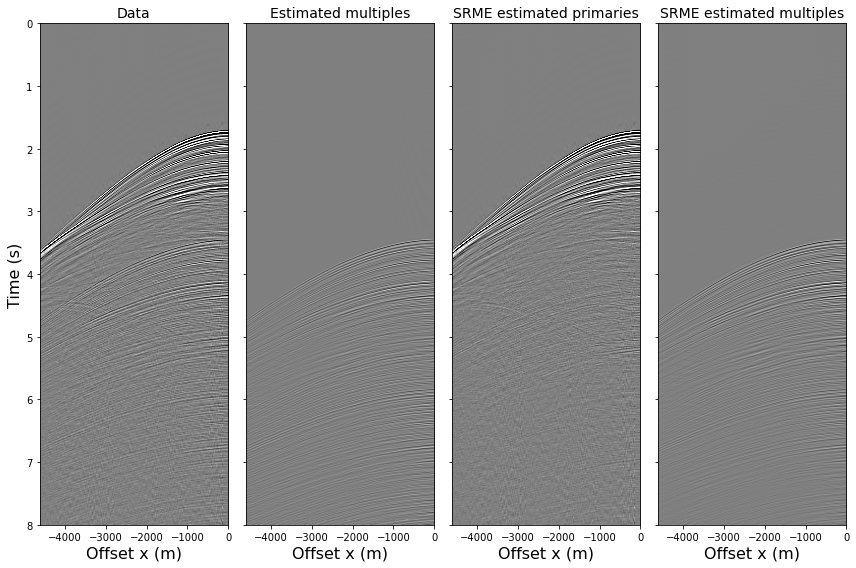

In [6]:
# plot the selected shot
vmax = 0.2 * np.amax(data)
vmin = -vmax
t0=0.0
t1=t0+(ns-1)*dt
# plt.figure(figsize=[5,20])
# plt.imshow(data.T, aspect=2000, vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0])
# plt.title('First shot %d with %d traces' %(fldr[0],nxshot))
# plt.xlabel('Offset x (m)')
# plt.ylabel('Time (s)')
# plt.show()
# time.sleep(1)

vmax = 0.05*np.amax(data)
vmin = -vmax
xmin = offset[itr1]
xmax = offset[itr2]
sxscl = sx[itr1]*scl
fig, axs = plt.subplots(1, 4, figsize=(12,8),sharey=True)
axs[0].imshow(data.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[0].set_title('Data',fontsize=14)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(multiples.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[1].set_title('Estimated multiples',fontsize=14)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(srme.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[2].set_title('SRME estimated primaries',fontsize=14)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow((data - srme).T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[3].set_title('SRME estimated multiples',fontsize=14)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

We now apply the ADMM algorithm to the Voring dataset. For field data adaptive subtraction is done in patches, where every patch corresponds to one filter. We start by looking at the result for 1 patch first and then move on to the entire shot gather.

In [7]:
from pylops.optimization.solver import lsqr

In [45]:
nr, nt = 180, 1950
data = data[:nr, :nt]
multiples = multiples[:nr, :nt]
srme = srme[:nr, :nt]

# set the filter size
nfilt = 11

# Create patching operator
dimsd = (nr, nt)
nwin = (30, 150)
nover = (15, 75)
nop = nwin
nwins = (nr // (nwin[0]//2) - 1, nt // (nwin[1]//2) - 1)
dims = (nwins[0]*nop[0], 
        nwins[1]*nop[1])
I = pylops.Identity(nwin[0]*nwin[1])

# Get the patching operators
PatchOpH = pylops.signalprocessing.Patch2D(I, dims, dimsd, nwin, nover, nop, tapertype='none', design=False)
PatchOp  = pylops.signalprocessing.Patch2D(I, dims, dimsd, nwin, nover, nop, tapertype='hanning', design=False)

# Patch the data
data_patched = PatchOpH.H * data.ravel()
multiples_patched = PatchOpH.H * multiples.ravel()

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

Let's check whether the patching operators are correct

In [13]:
data_back = PatchOp * data_patched
data_back = data_back.reshape(data.shape)
np.linalg.norm(data - data_back)

5.675910072290665e-13

Below we select one patch indicated by the red square

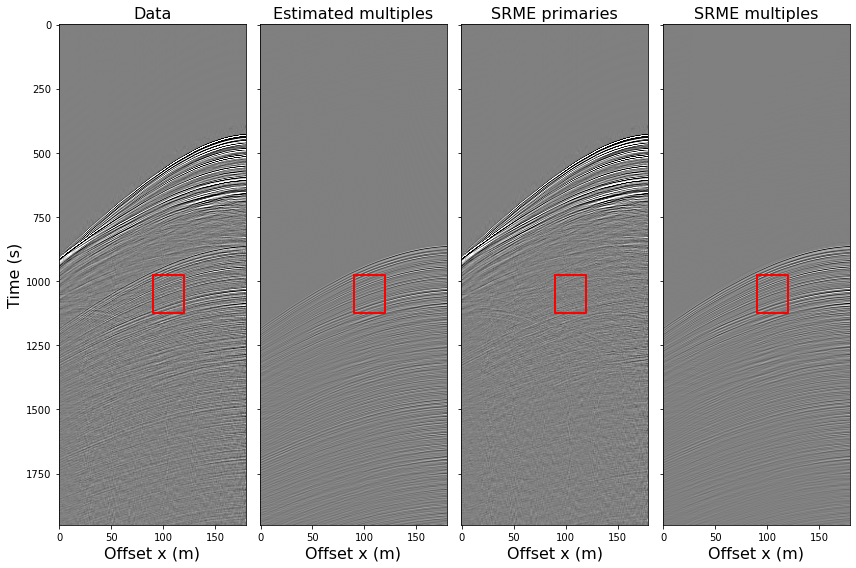

In [9]:
xs = [90, 90, 120, 120, 90]
ys = [975, 1125, 1125, 975, 975]

fig, axs = plt.subplots(1, 4, figsize=(12,8),sharey=True)
axs[0].imshow(data.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Data',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[0].plot(xs, ys, color='red', linewidth=2)
axs[1].imshow(multiples.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated multiples',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[1].plot(xs, ys, color='red', linewidth=2)
axs[2].imshow(srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('SRME primaries',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[2].plot(xs, ys, color='red', linewidth=2)
axs[3].imshow(data.T - srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('SRME multiples',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[3].plot(xs, ys, color='red', linewidth=2)
plt.tight_layout()

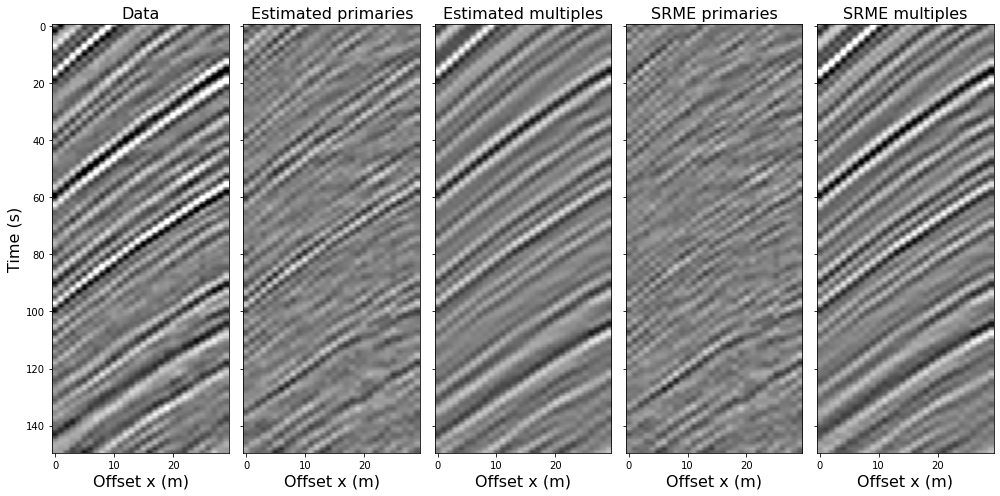

In [10]:
vmax = 0.05*np.amax(data)
vmin = -vmax

patch_srme = srme.T[975:1125, 90:120]
patch_multiples = multiples.T[975:1125, 90:120]
patch_data = data.T[975:1125, 90:120]
fig, axs = plt.subplots(1, 5, figsize=(14,7),sharey=True)
axs[0].imshow(patch_data, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Data',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(patch_data - patch_multiples, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated primaries',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(patch_multiples, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Estimated multiples',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('SRME primaries',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[4].imshow(patch_data - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[4].set_title('SRME multiples',fontsize=16)
axs[4].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

We first apply adaptive subtraction using the $L_2$-norm

In [17]:
CopStack = []
for i in range(nwin[0]):
    C = pylops.utils.signalprocessing.convmtx(patch_multiples[:, i], nfilt)
    Cop = pylops.basicoperators.MatrixMult(C[nfilt//2:-(nfilt//2)])
    CopStack.append(Cop)
    
dataStack = patch_data.T.ravel()
CopStack  = pylops.VStack(CopStack)

In [38]:
filt_est = lsqr(CopStack, dataStack, x0 = np.zeros(nfilt), damp=0, niter=int(4e1))[0]
print(np.linalg.norm(CopStack.H * (CopStack * filt_est) - CopStack.H * dataStack))
multiple_est = (CopStack * filt_est)
primary_est = dataStack.T - multiple_est
multiple_est = np.reshape(multiple_est, (nwin[0], nwin[1]))
primary_est = np.reshape(primary_est, (nwin[0], nwin[1]))

0.002928174527189022


Let's compare the results for $L_2$ adaptive subtraction to the initial estimate of SRME

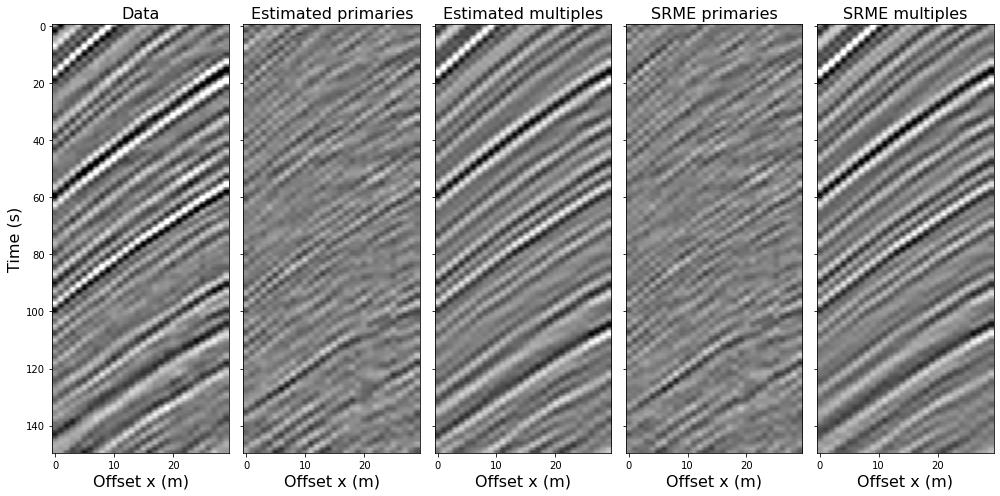

In [39]:
fig, axs = plt.subplots(1, 5, figsize=(14,7),sharey=True)
axs[0].imshow(patch_data, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Data',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(primary_est.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated primaries',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(multiple_est.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Estimated multiples',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('SRME primaries',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[4].imshow(patch_data - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[4].set_title('SRME multiples',fontsize=16)
axs[4].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

Now let's look at the estimated filter.

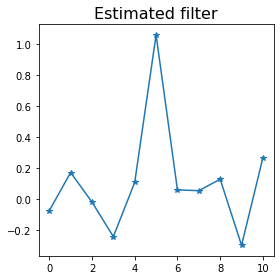

In [40]:
fig, axs = plt.subplots(1, 1, figsize=(4, 4))
axs.plot(filt_est, '*-')
axs.set_title('Estimated filter', fontsize=16)
plt.tight_layout();

Now we try to enforce a spiky filter. This can be done by imposing an $L_1$-penalty on the solution. We still use an $L_2$-norm for the data and the resulting optimization problem is solved using FISTA.

In [121]:
filt_fista = FISTA(CopStack, dataStack, niter=100, eps=3e4)[0]

# make the multiples and primaries
multiple_fista = CopStack * filt_fista
primary_fista = dataStack - multiple_fista
multiple_fista = np.reshape(multiple_fista, (nwin[0], nwin[1]))
primary_fista = np.reshape(primary_fista, (nwin[0], nwin[1]))

Let's compare the filter to the one obtained with $L_2$ regularization.

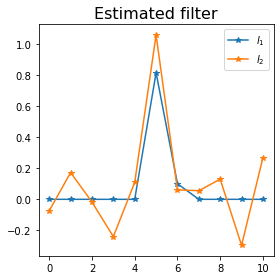

In [122]:
fig, axs = plt.subplots(1, 1, figsize=(4, 4))
axs.plot(filt_fista, '*-', label='Filter')
axs.plot(filt_est, '*-', label='$l_2$')
axs.set_title('Estimated filter', fontsize=16)
plt.tight_layout();
plt.legend();

Now we apply an $L_1$ norm on the data as well and use the modified ADMM algorithm to solve the resulting optimization problem

In [92]:
filt_l1 = ADMM(CopStack, dataStack, rho=1e0, nouter=500, ninner=5, eps=3e7, decay=None)

# reconstruct the primaries and multiples
multiple_l1 = CopStack * filt_l1
primary_l1 = dataStack - multiple_l1
multiple_l1 = np.reshape(multiple_l1, (nwin[0], nwin[1]))
primary_l1 = np.reshape(primary_l1, (nwin[0], nwin[1]))

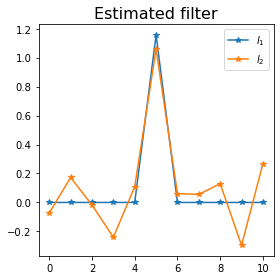

In [93]:
fig, axs = plt.subplots(1, 1, figsize=(4, 4))
axs.plot(filt_l1, '*-', label='$l_1$')
axs.plot(filt_est, '*-', label='$l_2$')
axs.set_title('Estimated filter', fontsize=16)
plt.tight_layout();
plt.legend();

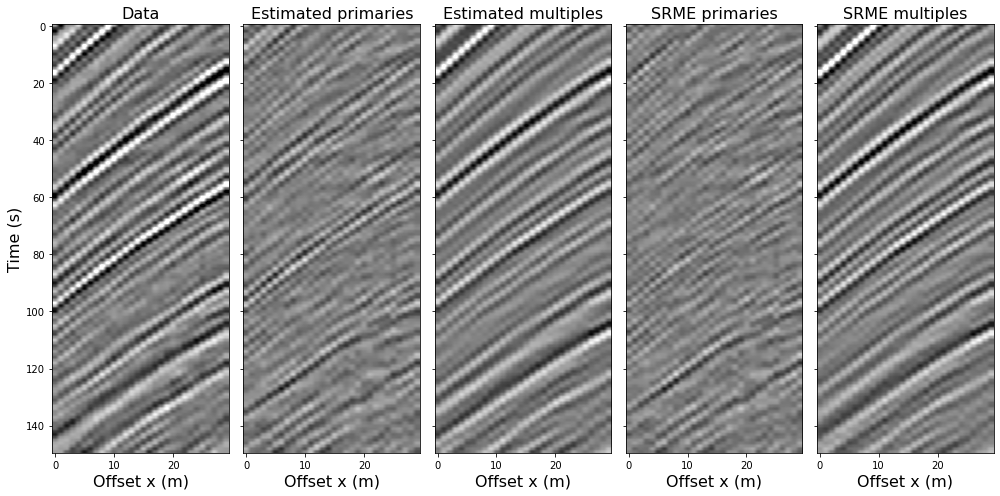

In [94]:
vmax = 0.05*np.amax(data)
vmin = -vmax
fig, axs = plt.subplots(1, 5, figsize=(14,7),sharey=True)
axs[0].imshow(patch_data, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Data',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(primary_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated primaries',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(multiple_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Estimated multiples',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('SRME primaries',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[4].imshow(patch_data - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[4].set_title('SRME multiples',fontsize=16)
axs[4].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

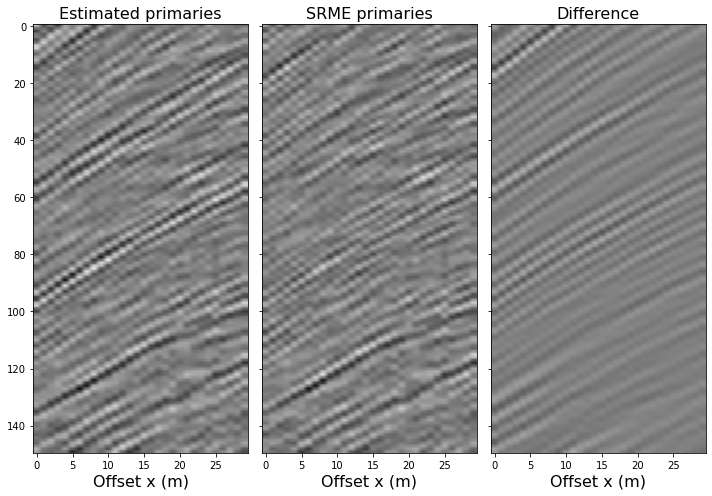

In [95]:
fig, axs = plt.subplots(1, 3, figsize=(10,7),sharey=True)
axs[0].imshow(primary_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Estimated primaries',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[1].imshow(patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('SRME primaries',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(primary_l1.T - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Difference',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

Now let's look at the results when we use the IRLS algorithm instead

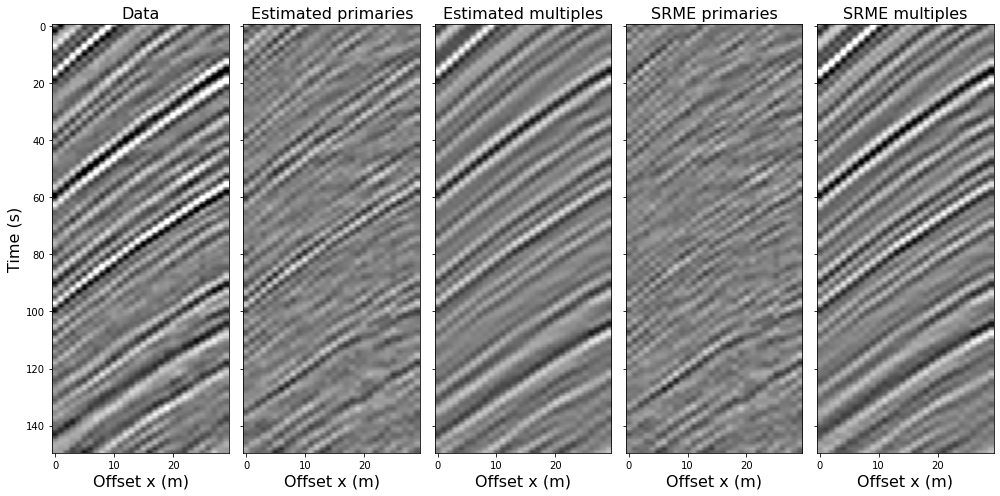

In [361]:
patch_srme = srme.T[975:1125, 90:120]
patch_multiples = multiples.T[975:1125, 90:120]
patch_data = data.T[975:1125, 90:120]
fig, axs = plt.subplots(1, 5, figsize=(14,7),sharey=True)
axs[0].imshow(patch_data, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Data',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(patch_data - patch_multiples, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated primaries',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(patch_multiples, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Estimated multiples',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('SRME primaries',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[4].imshow(patch_data - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[4].set_title('SRME multiples',fontsize=16)
axs[4].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

In [ ]:
filt_irls = IRLS_model(CopStack, dataStack, nouter=4000, ninner=5, epsR=1e-2, x0=None)

# reconstruct the primaries and multiples
multiple_irls = CopStack * filt_irls
primary_irls = dataStack - multiple_irls
multiple_irls = np.reshape(multiple_irls, (nwin[0], nwin[1]))
primary_irls = np.reshape(primary_irls, (nwin[0], nwin[1]))

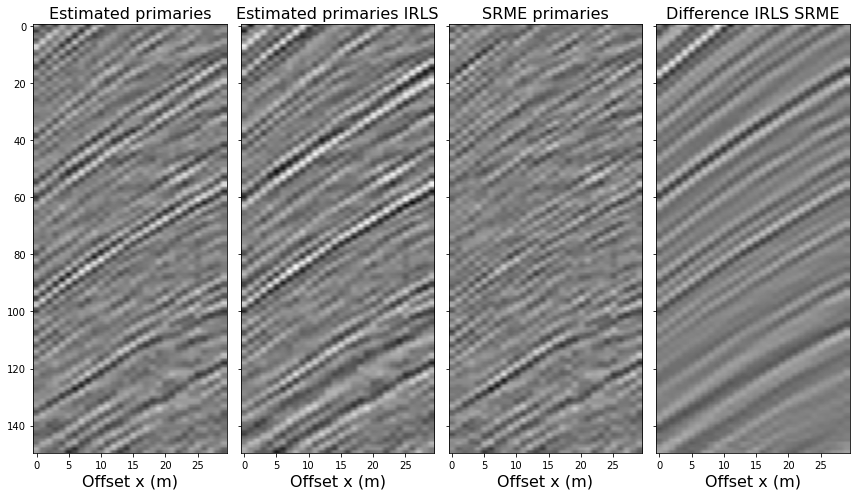

In [390]:
fig, axs = plt.subplots(1, 4, figsize=(12,7),sharey=True)
axs[0].imshow(patch_data - patch_multiples, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Estimated primaries',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[1].imshow(primary_irls.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated primaries IRLS',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('SRME primaries',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(primary_irls.T - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('Difference IRLS SRME',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

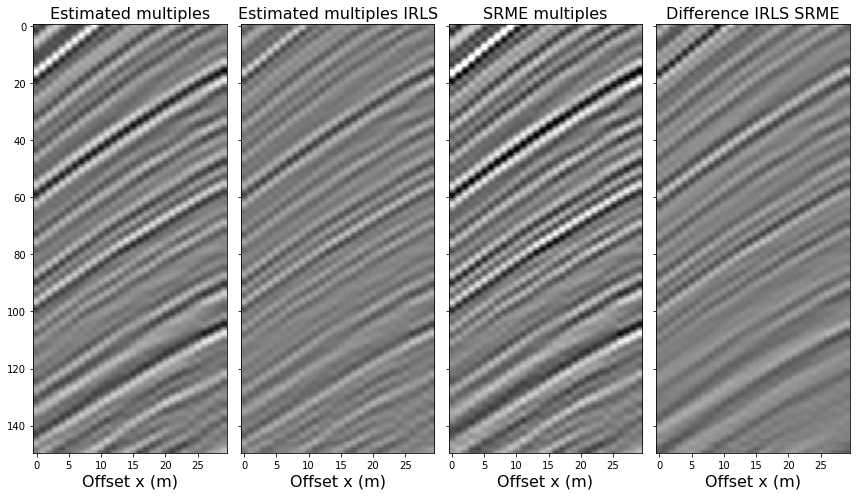

In [391]:
fig, axs = plt.subplots(1, 4, figsize=(12,7),sharey=True)
axs[0].imshow(patch_multiples, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Estimated multiples',fontsize=16)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[1].imshow(multiple_irls.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated multiples IRLS',fontsize=16)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(patch_data - patch_srme, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('SRME multiples',fontsize=16)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(multiple_irls.T - (patch_data - patch_srme), aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('Difference IRLS SRME',fontsize=16)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

We now reorder the data to have easy access to the patches

In [14]:
# Reorder the data so that every row is a single patch
num_patches = nwins[0] * nwins[1]
data_patched = np.reshape(data_patched, (num_patches, nwin[0]*nwin[1]))
multiples_patched = np.reshape(multiples_patched, (num_patches, nwin[0]*nwin[1]))
primary_est = np.zeros_like(data_patched)
multiple_est = np.zeros_like(multiples_patched)

Plot the patches

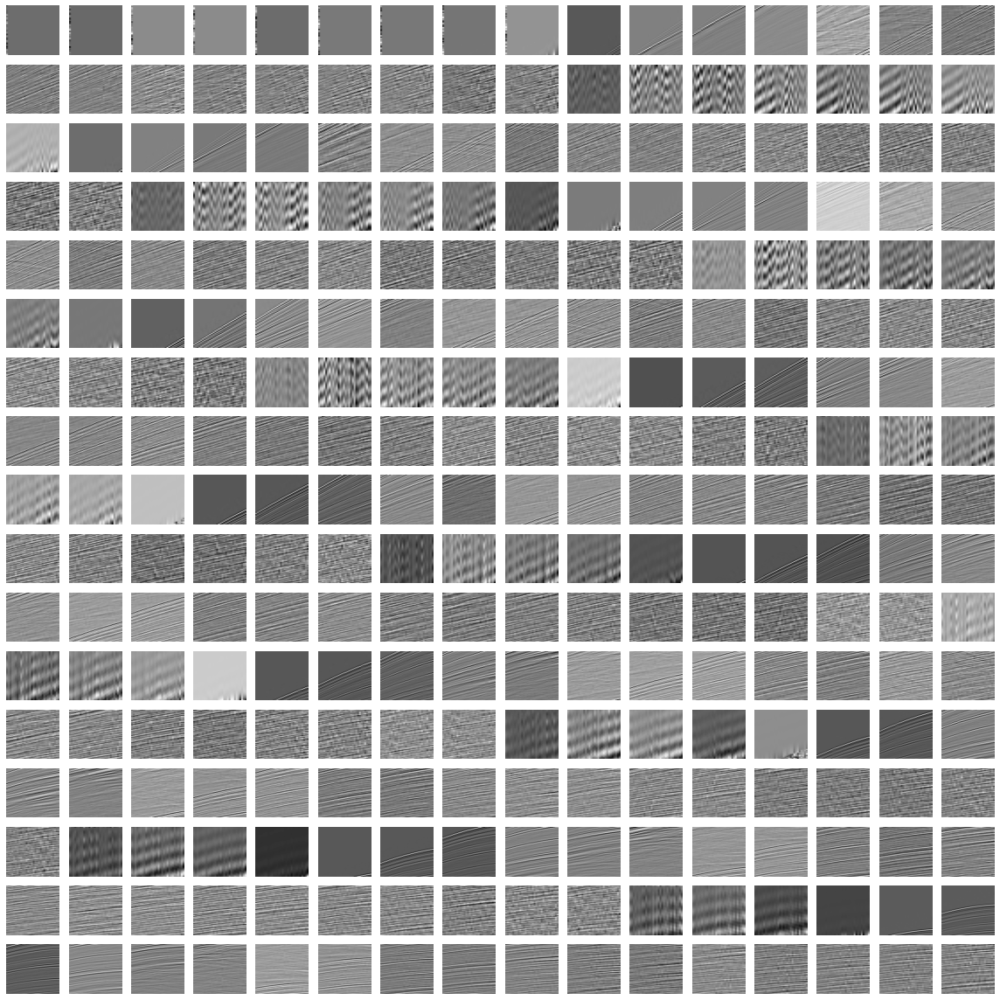

In [15]:
fig, axs = plt.subplots(17, 16, figsize=(16, 16), sharey=True, sharex=True)
axs = axs.ravel()
for i in range(int(17*16)):
    data_patch_i = np.reshape(data_patched[i, :], (nwin[0], nwin[1]))
    axs[i].imshow(data_patch_i.T, aspect='auto', cmap='gray')
    axs[i].axis('off');
    plt.tight_layout();

Below we do adaptive subtraction for every patch with an $L_2$-norm on the data

In [407]:
for i in range(num_patches):
    data_patch_i = np.reshape(data_patched[i], (nwin[0], nwin[1]))
    multiple_patch_i = np.reshape(multiples_patched[i], (nwin[0], nwin[1]))
    CopStack = []
    # construct the convolutional operator
    for j in range(nwin[0]):
        C = pylops.utils.signalprocessing.convmtx(multiple_patch_i[j], nfilt)
        Cop = pylops.basicoperators.MatrixMult(C[nfilt//2:-(nfilt//2)])
        CopStack.append(Cop)
    dataStack = data_patch_i.ravel()
    CopStack  = pylops.VStack(CopStack)
    # solve for the filter
    filt_est = lsqr(CopStack, dataStack, x0=np.zeros(nfilt), niter=15)[0]
    multiple_est[i] = (CopStack * filt_est).T # Make sure it's in (nr, nt) format before patching back! 
    primary_est[i]  = (dataStack - multiple_est[i].T).T
# Glue the patches back together
primary_est = PatchOp * primary_est.ravel()
multiple_est = PatchOp * multiple_est.ravel()
primary_est = np.reshape(primary_est, (nr, nt))
multiple_est = np.reshape(multiple_est, (nr, nt))

Plot the results

In [ ]:
vmax = 0.005*np.amax(data)
vmin = -vmax
xmin = offset[itr1]
xmax = offset[itr2]
sxscl = sx[itr1]*scl
fig, axs = plt.subplots(1, 4, figsize=(12,7),sharey=True)
axs[0].imshow(data.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[0].set_title('Data',fontsize=14)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(multiple_est.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[1].set_title('Estimated multiples',fontsize=14)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(primary_est.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[2].set_title('Estimated primaries',fontsize=14)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(data.T - primary_est.T, aspect='auto', vmin=vmin, vmax=vmax, extent=[xmin,xmax,t1,t0], cmap='gray')
axs[3].set_title('Data - estimated primaries',fontsize=14)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

... and compare to the SRME result

In [ ]:
vmax = 0.005*np.amax(data)
vmin = -vmax
xmin = offset[itr1]
xmax = offset[itr2]
sxscl = sx[itr1]*scl
fig, axs = plt.subplots(1, 4, figsize=(12,7),sharey=True)
axs[0].imshow(primary_est.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('Estimated primaries',fontsize=14)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(multiple_est.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('Estimated multiples',fontsize=14)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('SRME primaries',fontsize=14)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow((data - srme).T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('SRME multiples',fontsize=14)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

Again, we compare against the modified ADMM algorithm

In [246]:
for i in range(num_patches):
    if i%20 == 0:
        print(i)
    data_patch_i = np.reshape(data_patched[i], (nwin[0], nwin[1]))
    multiple_patch_i = np.reshape(multiples_patched[i], (nwin[0], nwin[1]))
    CopStack = []
    # construct the convolutional operator
    for j in range(nwin[0]):
        C = pylops.utils.signalprocessing.convmtx(multiple_patch_i[j], nfilt)
        Cop = pylops.basicoperators.MatrixMult(C[nfilt//2:-(nfilt//2)])
        CopStack.append(Cop)
    dataStack = data_patch_i.ravel()
    CopStack  = pylops.VStack(CopStack)
    # solve for the filter
    filt_l1 = ADMM(CopStack, dataStack, rho=1e0, outer_its=2000, inner_its=5, eps=0e0)
    multiple_l1[i] = (CopStack * filt_l1).T # Make sure it's in (nr, nt) format before patching back! 
    primary_l1[i]  = (dataStack - multiple_l1[i].T).T
# Glue the patches back together
primary_l1 = PatchOp * primary_l1.ravel()
multiple_l1 = PatchOp * multiple_l1.ravel()
primary_l1 = np.reshape(primary_l1, (nr, nt))
multiple_l1 = np.reshape(multiple_l1, (nr, nt))

0
20
40
60
80
100
120
140
160
180
200
220
240
260


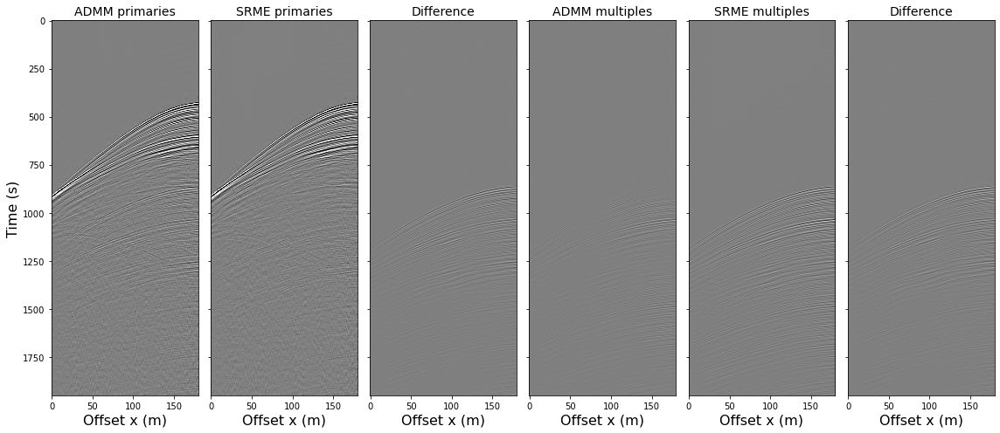

In [425]:
vmax = 0.05*np.amax(data)
vmin = -vmax
xmin = offset[itr1]
xmax = offset[itr2]
sxscl = sx[itr1]*scl
fig, axs = plt.subplots(1, 6, figsize=(16,7),sharey=True, sharex=True)
axs[0].imshow(primary_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('ADMM primaries',fontsize=14)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('SRME primaries',fontsize=14)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(primary_l1.T - srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Difference',fontsize=14)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(multiple_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('ADMM multiples',fontsize=14)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[4].imshow((data - srme).T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[4].set_title('SRME multiples',fontsize=14)
axs[4].set_xlabel('Offset x (m)',fontsize=16)
axs[5].imshow(multiple_l1.T - (data - srme).T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[5].set_title('Difference',fontsize=14)
axs[5].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

# Below is all junk ignore it

Text(0.5, 0, 'Offset x (m)')

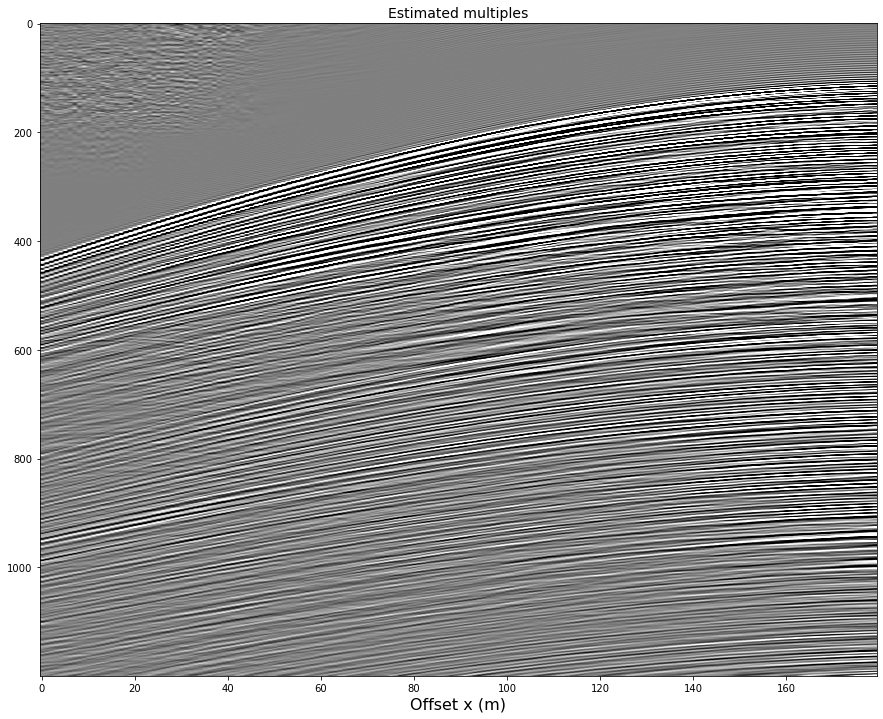

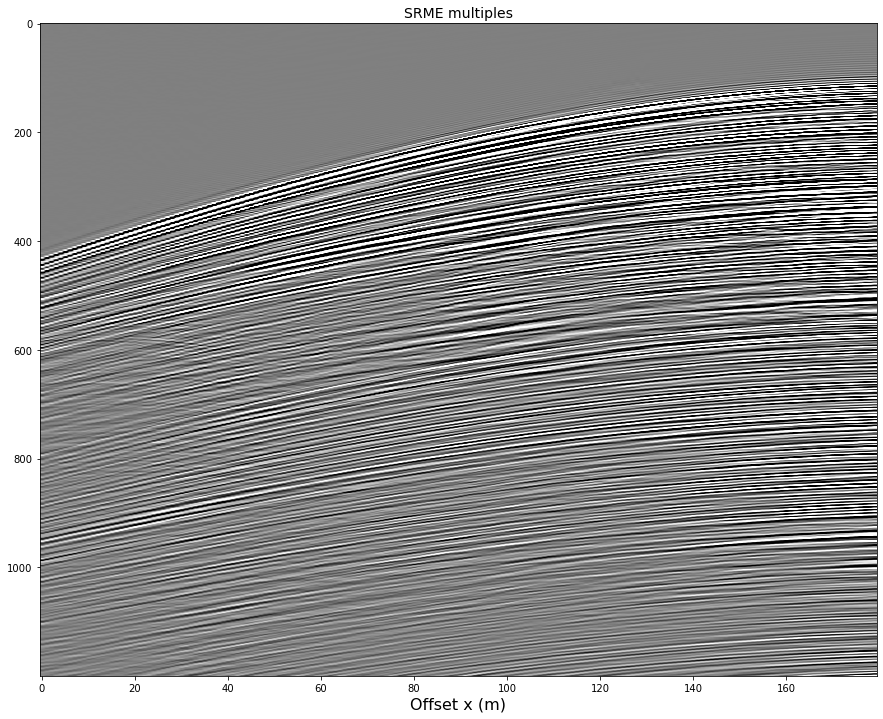

In [413]:
vmax = 0.01*np.amax(data)
vmin = -vmax


fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(multiple_est.T[750:], aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('Estimated multiples',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16)

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow((data - srme).T[750:], aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('SRME multiples',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16);

Text(0.5, 0, 'Offset x (m)')

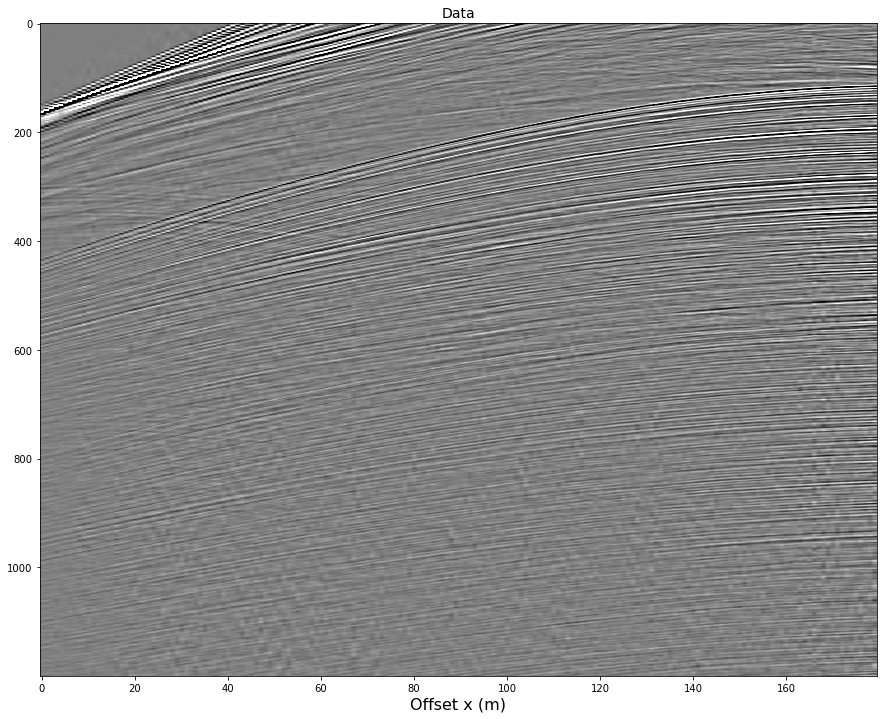

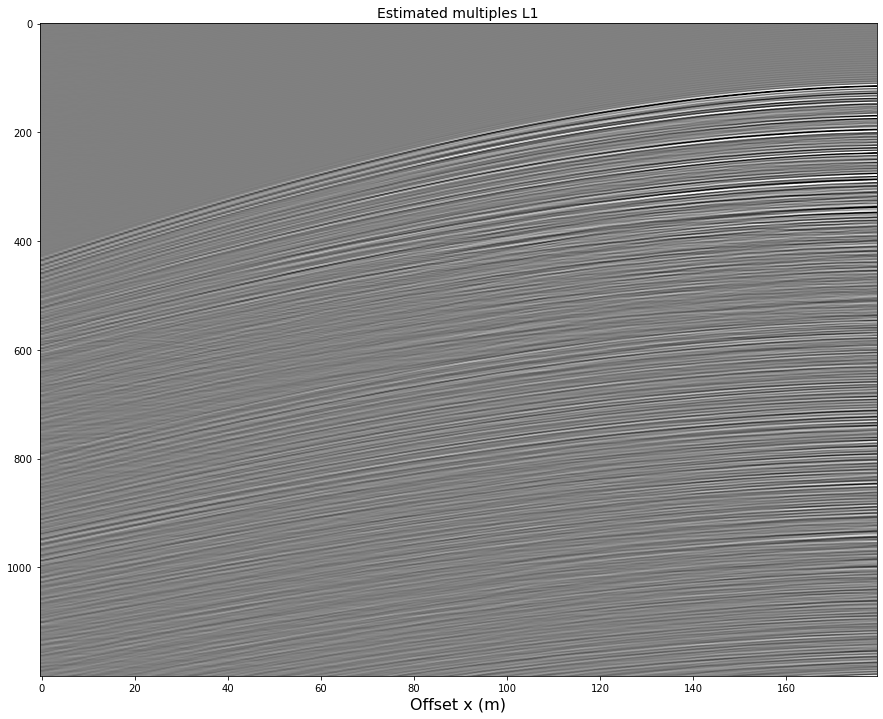

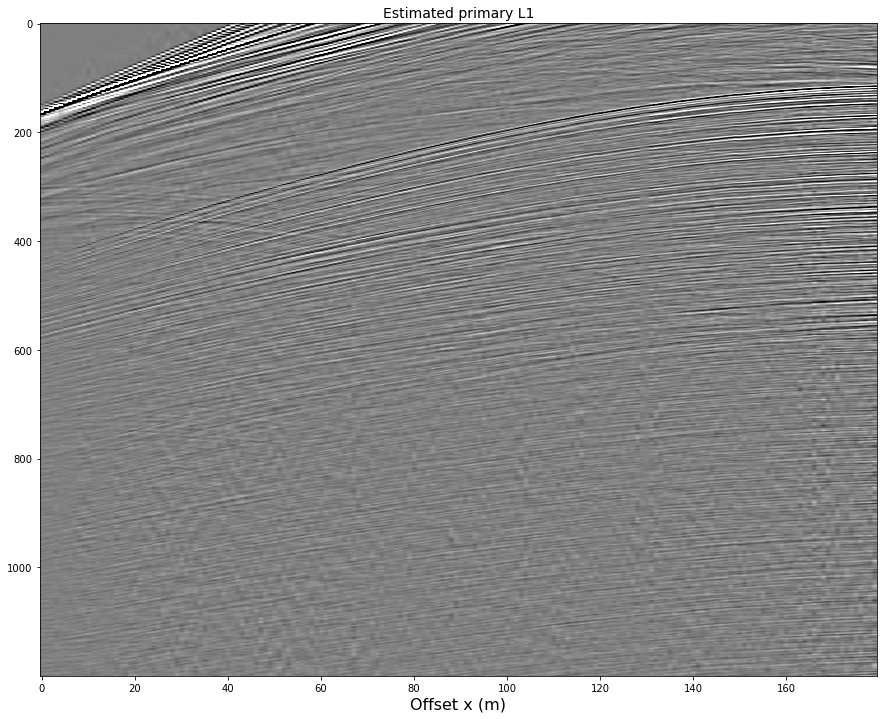

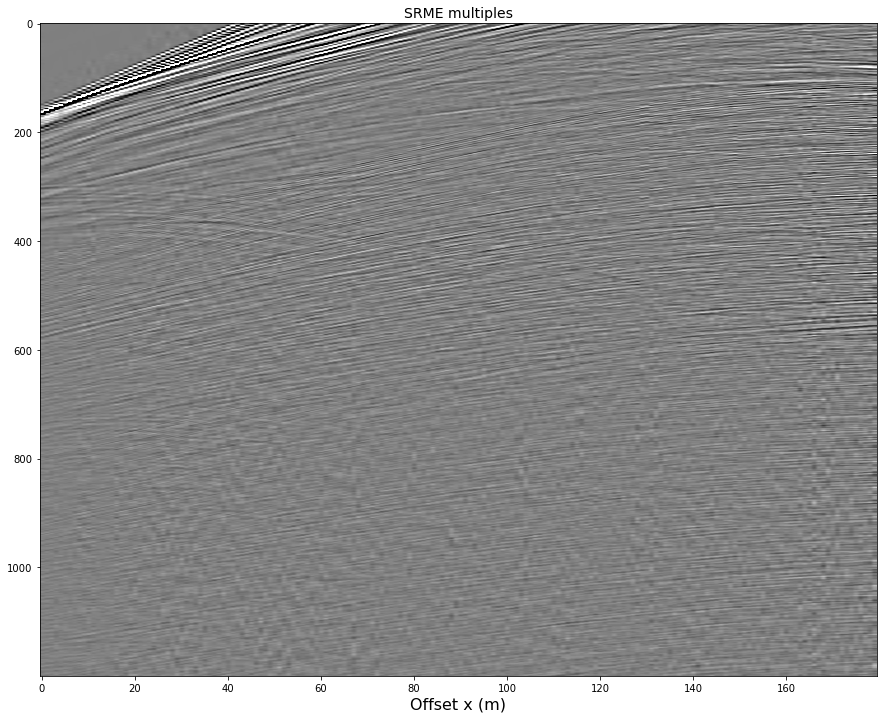

In [427]:
vmax = 0.05*np.amax(data)
vmin = -vmax

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(data.T[750:], aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('Data',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16)

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(multiples.T[750:], aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('Estimated multiples L1',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16)

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(primary_l1.T[750:], aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('Estimated primary L1',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16)

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(srme.T[750:], aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('SRME multiples',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16)

(-10000.0, 10000.0)

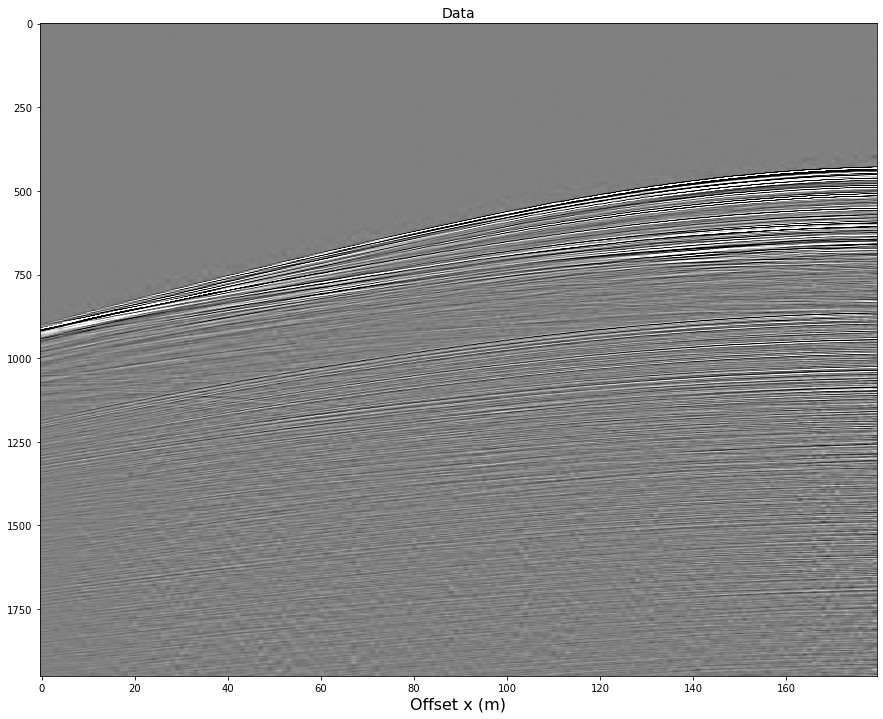

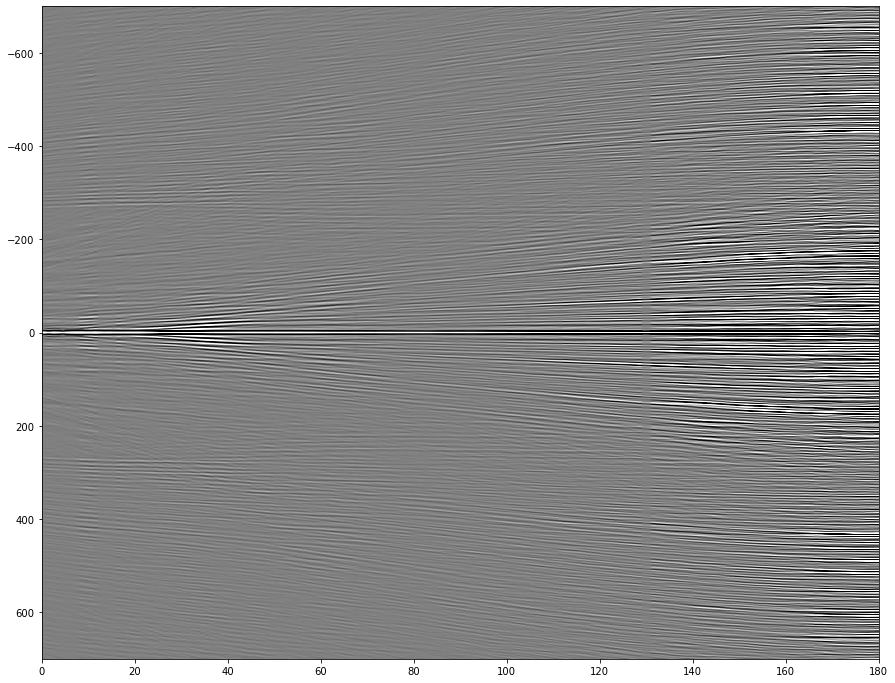

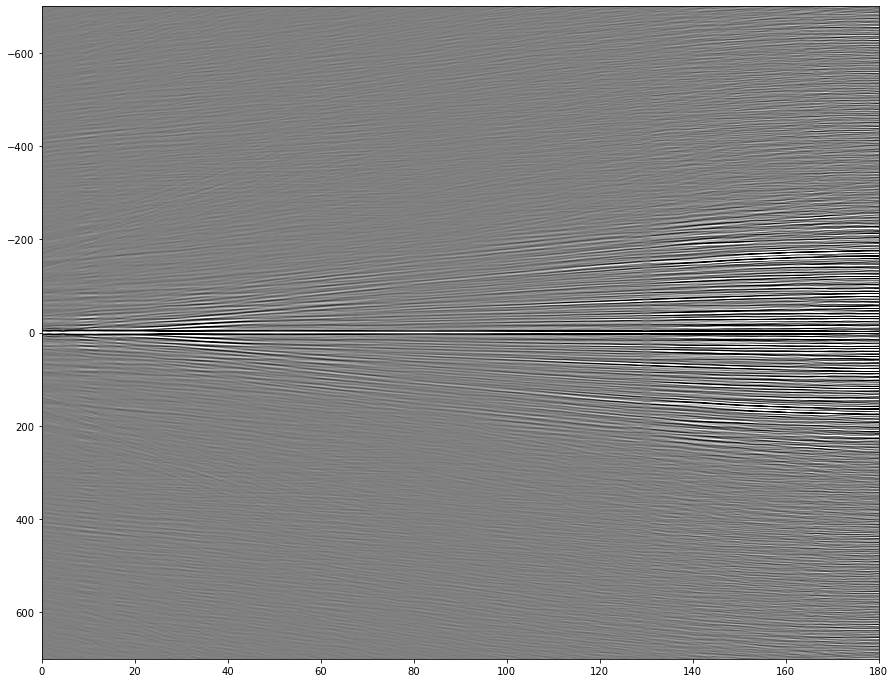

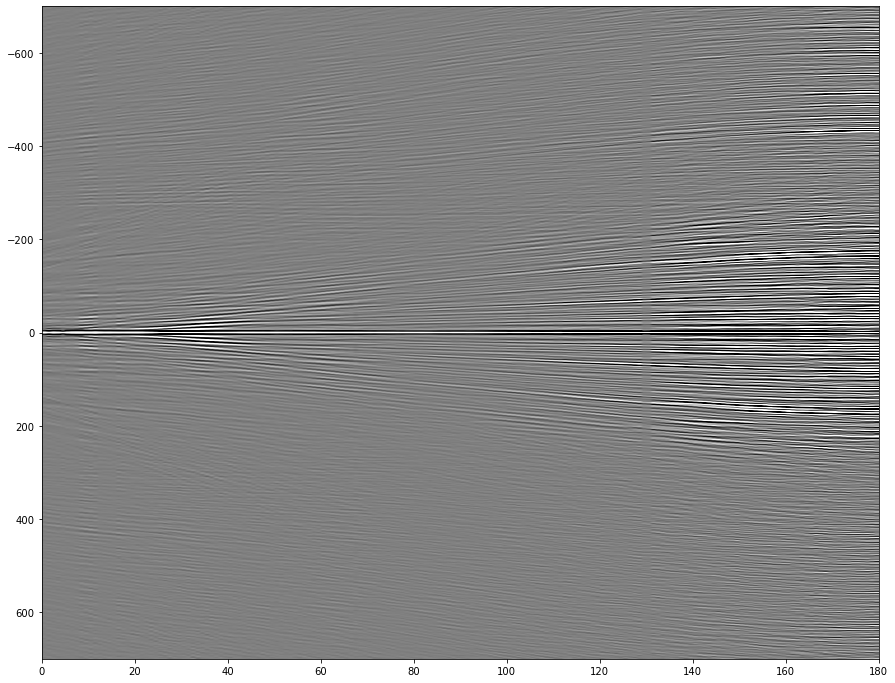

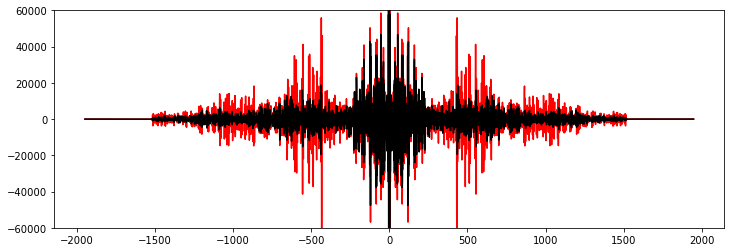

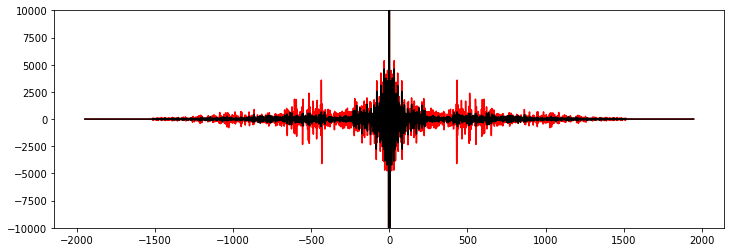

In [468]:
fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(data.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
ax.set_title('Data',fontsize=14)
ax.set_xlabel('Offset x (m)',fontsize=16)

import scipy as sp
autocorr_data = np.vstack([sp.signal.correlate(data[i], data[i]) for i in range(nr)])
autocorr_srme = np.vstack([sp.signal.correlate(srme[i], srme[i]) for i in range(nr)])
autocorr_priml1 = np.vstack([sp.signal.correlate(primary_l1[i], srme[i]) for i in range(nr)])

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(autocorr_data.T, aspect='auto', vmin=-1e4, vmax=1e4, cmap='gray',
         extent=[0, nr, -nt, nt])
ax.set_ylim(700, -700)

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(autocorr_srme.T, aspect='auto', vmin=-1e4, vmax=1e4, cmap='gray',
         extent=[0, nr, -nt, nt])
ax.set_ylim(700, -700)

fig, ax = plt.subplots(1, 1, figsize=(15,12),sharey=True)
ax.imshow(autocorr_priml1.T, aspect='auto', vmin=-1e4, vmax=1e4, cmap='gray',
         extent=[0, nr, -nt, nt])
ax.set_ylim(700, -700)



plt.figure(figsize=(12, 4))
plt.plot(np.arange(-nt, nt-1), autocorr_data[-1], 'r')
plt.plot(np.arange(-nt, nt-1), autocorr_srme[-1], 'k')
plt.ylim(-60000, 60000)

plt.figure(figsize=(12, 4))
plt.plot(np.arange(-nt, nt-1), np.mean(autocorr_data, axis=0), 'r')
plt.plot(np.arange(-nt, nt-1), np.mean(autocorr_srme, axis=0), 'k')
plt.ylim(-10000, 10000)

In [392]:
# Reorder the data so that every ROW is a single patch
num_patches = nwins[0]*nwins[1]
data_patched = np.reshape(data_patched, (num_patches, nwin[0]*nwin[1]))
multiples_patched = np.reshape(multiples_patched, (num_patches, nwin[0]*nwin[1]))
primary_l1 = np.zeros_like(data_patched)
multiple_l1 = np.zeros_like(multiples_patched)

for i in range(num_patches):
    if i % 20 == 0:
        print(i)
    data_patch_i = np.reshape(data_patched[i], (nwin[0], nwin[1]))
    multiple_patch_i = np.reshape(multiples_patched[i], (nwin[0], nwin[1]))
    CopStack = []
    # construct the convolutional operator
    for j in range(nwin[0]):
        C = pylops.utils.signalprocessing.convmtx(multiple_patch_i[j], nfilt)
        Cop = pylops.basicoperators.MatrixMult(C[nfilt//2:-(nfilt//2)])
        CopStack.append(Cop)
    dataStack = data_patch_i.ravel()
    CopStack  = pylops.VStack(CopStack)
    # solve for the filter
    filt_l1 = IRLS_model(CopStack, dataStack, nouter=4000, ninner=5, epsR=1e-2, x0=None)
    multiple_l1[i] = (CopStack * filt_l1).T # Make sure it's in (nr, nt) format before patching back! 
    primary_l1[i]  = (dataStack - multiple_l1[i].T).T
# Glue the patches back together
primary_l1 = PatchOp * primary_l1.ravel()
multiple_l1 = PatchOp * multiple_l1.ravel()
primary_l1 = np.reshape(primary_l1, (nr, nt))
multiple_l1 = np.reshape(multiple_l1, (nr, nt))

0
20
40
60
80
100
120
140
160
180
200
220
240
260


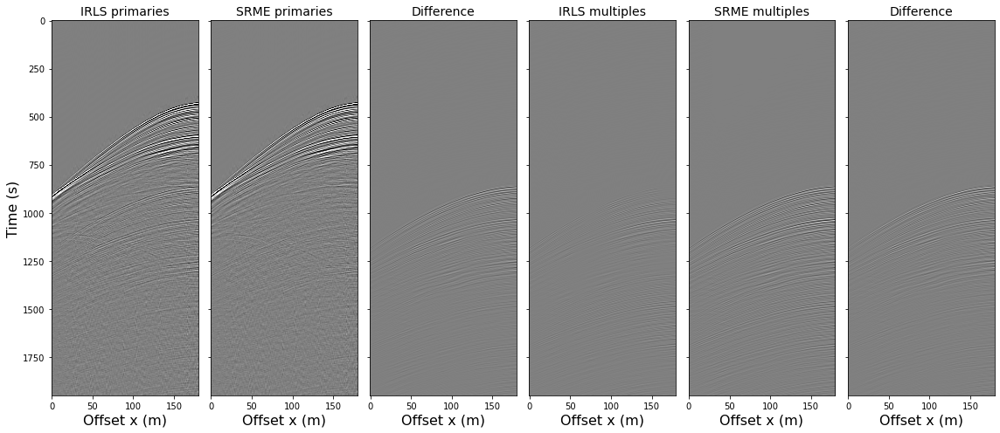

In [394]:
vmax = 0.05*np.amax(data)
vmin = -vmax
xmin = offset[itr1]
xmax = offset[itr2]
sxscl = sx[itr1]*scl
fig, axs = plt.subplots(1, 6, figsize=(16,7),sharey=True, sharex=True)
axs[0].imshow(primary_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[0].set_title('IRLS primaries',fontsize=14)
axs[0].set_xlabel('Offset x (m)',fontsize=16)
axs[0].set_ylabel('Time (s)',fontsize=16)
axs[1].imshow(srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[1].set_title('SRME primaries',fontsize=14)
axs[1].set_xlabel('Offset x (m)',fontsize=16)
axs[2].imshow(primary_l1.T - srme.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[2].set_title('Difference',fontsize=14)
axs[2].set_xlabel('Offset x (m)',fontsize=16)
axs[3].imshow(multiple_l1.T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[3].set_title('IRLS multiples',fontsize=14)
axs[3].set_xlabel('Offset x (m)',fontsize=16)
axs[4].imshow((data - srme).T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[4].set_title('SRME multiples',fontsize=14)
axs[4].set_xlabel('Offset x (m)',fontsize=16)
axs[5].imshow(multiple_l1.T - (data - srme).T, aspect='auto', vmin=vmin, vmax=vmax, cmap='gray')
axs[5].set_title('Difference',fontsize=14)
axs[5].set_xlabel('Offset x (m)',fontsize=16)
plt.tight_layout()

# Toy example

## Full data

In [4]:
par = {'ox':-220, 'dx':5, 'nx':88,
       'ot':0, 'dt':0.004, 'nt':200,
       'f0': 40}

# parameters
ns = par['nx']
nx = par['nx']
nt = par['nt']
dt = par['dt']

t0_plus = np.array([0.2, 0.25, 0.275, 0.30])
vrms = np.array([1700., 1800., 2000., 2100.])
amp = np.array([1., -0.6, 0.5, -0.3])
vel_sep = 1000.0 # velocity at separation level
rho_sep = 1000.0 # density at separation level

# Create axis
t, t2, x, y = makeaxis(par)

# Create wavelet
wav = ricker(t[:41], f0=par['f0'])[0]

# Create data
full_data = np.zeros((par['nx'], par['nt']))
_, full_data = hyperbolic2d(x - x[nx//2], t, t0_plus, vrms, amp, wav)

## Multiples

In [5]:
par = {'ox':-220, 'dx':5, 'nx':88,
       'ot':0, 'dt':0.004, 'nt':200,
       'f0': 40}

# parameters
nx = par['nx']
nt = par['nt']
dt = par['dt']

t0_plus = np.array([0.25, 0.275, 0.30])
vrms = np.array([1800., 2000., 2100.])
amp = np.array([-0.6, 0.5, -0.3])
vel_sep = 1000.0 # velocity at separation level
rho_sep = 1000.0 # density at separation level

# Create axis
t, t2, x, y = makeaxis(par)

# Create wavelet
wav = ricker(t[:41], f0=par['f0'])[0]

# Create data
multiples_synthetic = np.zeros((par['nx'], par['nt']))
_, multiples_synthetic = hyperbolic2d(x - x[nx//2], t, t0_plus, vrms, amp, wav)

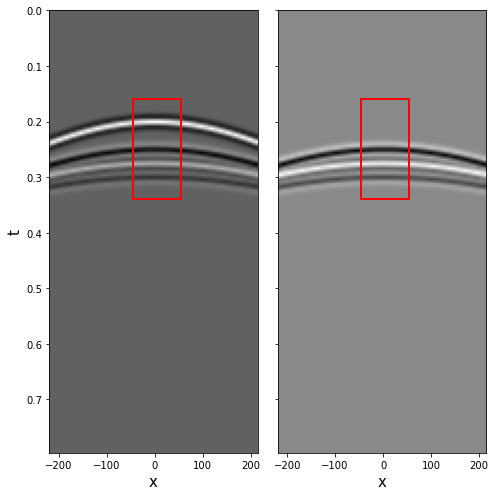

In [6]:
# x[35], x[55], t[40], t[85]
xs = [-45, 55, 55, -45, -45]
ys = [.16, .16, .34, .34, .16]

fig, axs = plt.subplots(1, 2, figsize=(7, 7), sharey=True)
axs[0].imshow(full_data.T, aspect='auto', cmap='gray', extent=(x.min(), x.max(), t.max(), t.min()))
axs[0].set_xlabel('x',fontsize=15)
axs[0].set_ylabel('t',fontsize=15);
axs[0].plot(xs, ys, color='red', linewidth=2)
axs[1].imshow(multiples_synthetic.T, aspect='auto', cmap='gray', extent=(x.min(), x.max(), t.max(), t.min()))
axs[1].set_xlabel('x',fontsize=15)
axs[1].plot(xs, ys, color='red', linewidth=2)
plt.tight_layout();

In [869]:
synthetic_patch = full_data[35:55, 40:85]
multiples_synthetic_patch = multiples_synthetic[35:55, 40:85]

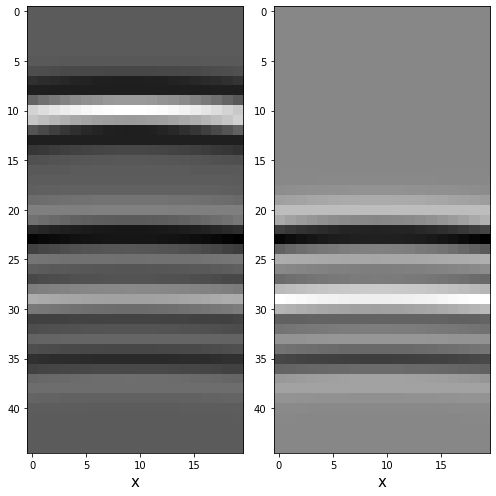

In [870]:
fig, axs = plt.subplots(1, 2, figsize=(7, 7))
axs[0].imshow(synthetic_patch.T, aspect='auto', cmap='gray')
axs[0].set_xlabel('x',fontsize=15)
axs[1].imshow(multiples_synthetic_patch.T, aspect='auto', cmap='gray')
axs[1].set_xlabel('x',fontsize=15)
plt.tight_layout();

In [875]:
CopStack = []
for i in range(20):
    C = pylops.utils.signalprocessing.convmtx(multiples_synthetic_patch[i, :], nfilt)
    Cop = pylops.basicoperators.MatrixMult(C[nfilt//2:-(nfilt//2)])
    CopStack.append(Cop)
    
dataStack = synthetic_patch.ravel()
CopStack  = pylops.VStack(CopStack)

In [876]:
from pylops.optimization.solver import lsqr as lsqr
filt_est = lsqr(CopStack, dataStack, x0 = np.zeros(nfilt), damp=0, niter=int(2e1))[0]
multiple_est = CopStack * filt_est
primary_est = dataStack - multiple_est
multiple_est = np.reshape(multiple_est, (20, 45))
primary_est = np.reshape(primary_est, (20, 45))

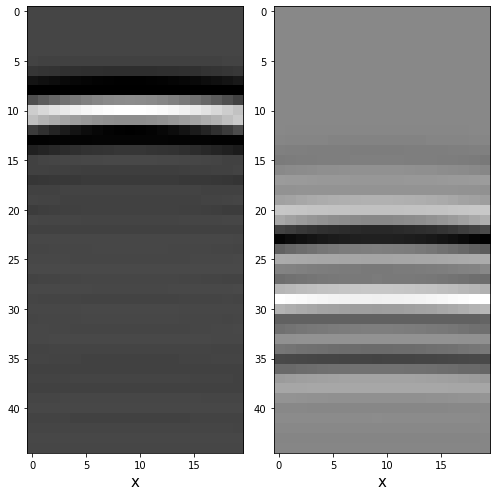

In [877]:
fig, axs = plt.subplots(1, 2, figsize=(7, 7))
axs[0].imshow(primary_est.T, aspect='auto', cmap='gray')
axs[0].set_xlabel('x',fontsize=15)
axs[1].imshow(multiple_est.T, aspect='auto', cmap='gray')
axs[1].set_xlabel('x',fontsize=15)
plt.tight_layout();

In [153]:
import scipy as sp
dx = 5
dt = 0.004
grid_orig_x, grid_orig_t = np.meshgrid(x, t)
grid_x, grid_t = np.meshgrid(np.linspace(x[0], x[-1], 2*nx), np.linspace(t[0], t[-1], 2*nt))
points = np.array([grid_orig_x.ravel(), grid_orig_t.ravel()]).T

data_interp = sp.interpolate.griddata(points, full_data.T.ravel(), (grid_x, grid_t), method='linear')

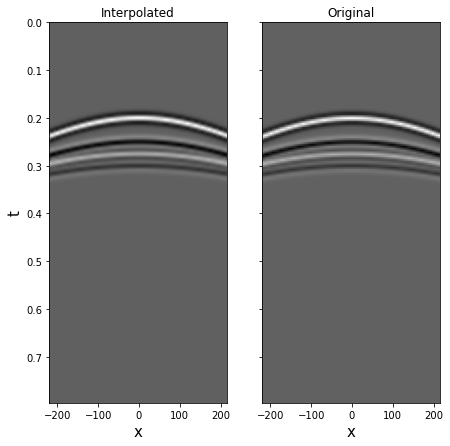

In [160]:
fig, axs = plt.subplots(1, 2, figsize=(7, 7), sharey=True)
axs[0].imshow(data_interp, aspect='auto', cmap='gray', extent=(x.min(), x.max(), t.max(), t.min()))
axs[0].set_xlabel('x',fontsize=15)
axs[0].set_ylabel('t',fontsize=15);
axs[0].set_title('Interpolated')
axs[1].imshow(full_data.T, aspect='auto', cmap='gray', extent=(x.min(), x.max(), t.max(), t.min()))
axs[1].set_xlabel('x',fontsize=15)
axs[1].set_title('Original');